# Real Housewives of Lagos (RHOL) Reality TV series Analysis using Natural Language Processing

*This is a notebook by Ogechi Anoliefo.*

## Steps:
<a href="#importing-libraries" style="text-decoration:none">1. Import Libraries</a>


<a href="#tweets-mining" style="text-decoration:none">2. Tweets Mining</a>


<a href="#data-cleaning" style="text-decoration:none">3. Data Cleaning</a>


<a href="#sentiment-analysis" style="text-decoration:none">4. Sentiment Analysis</a>
  

<a href="#tweets-processing" style="text-decoration:none">5. Tweets Processing</a>  

<a href="#word-cloud" style="text-decoration:none">6. Word Cloud</a>

<a href="#location-geocoding" style="text-decoration:none">7. Location Geocoding and Map Visualization</a>
  

### 1. Import Libraries <a id='importing-libraries'></a> 

In [1]:
## IMPORTING THE LIBRARIES TO BE USED IN THIS PROJECT

import pandas as pd #primary data structure library
import numpy as np #for working with arrays and carrying out mathematical operations
import requests #for making HTTP requests
import json #for encoding and decoding json data
from collections import Counter

#for scraping tweets from X
# import asyncio
# import twscrape
# from twscrape import API, gather
# from twscrape.logger import set_log_level

#to find files/paths that match a specified pattern
import glob
import os

#for processing textual data
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk import pos_tag
from nltk.stem import WordNetLemmatizer
from nltk.probability import FreqDist
from textblob import TextBlob
import re
import string
import sys
from unicodedata import category
import demoji

#for creating visualizations
import matplotlib.pyplot as plt
import plotly.graph_objs as go
import plotly.express as px
from wordcloud import WordCloud
from PIL import Image 
import folium 
import random
import kaleido

#needed to display my plotly chart in my website/blog post
import chart_studio
username = "oge"
api_key = "4hXyGGJ6Fvvh9xWwSnwG"
chart_studio.tools.set_credentials_file(username=username, api_key=api_key)
import chart_studio.plotly as py
import chart_studio.tools as tls

#for location geocoding
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter

### 2. Tweets Mining <a id='tweets-mining'></a> 

To mine the tweets, I made use of the Python library **twscrape**. The library works through an authorised API, so you will need X account(s) in order to use it. You need your X username and password, and also the email associated with your X account and its password to be able to mine tweets. 

The library is designed to automatically switch accounts when the X API limit has been reached per 15-minute interval. So you can add multiple accounts to the API pool in order to change to a different account and continue scraping when the other accounts have reached their API limits. I used two accounts in order to make scraping faster and stored the mined tweets in csv files.

If you would like to read more about twscrape, and how you can use it to scrape tweets, you can check out their official documentations [here](https://pypi.org/project/twscrape/) and [here](https://github.com/vladkens/twscrape).

The code block below illustrates how to add the required credentials. **@username, password, email and email_pass** represent **your X account username, your X account password, the email associated with your X account and its password** respectively. 

In [2]:
#credentials required to use twscrape
# api = API()  #create an instance of the twscrape API object 
# await api.pool.add_account("@username", "password", "email", "email_pass") #add X account and email credentials 
# await api.pool.add_account("@username", "password", "email", "email_pass") #add X account and email credentials
# await api.pool.login_all()  #logs in to all the accounts provided 

import pandas as pd

During my first tweet scraping attempt, the search range in my query spanned over ten weeks (from 2023-09-29 to 2023-12-19) and the program took very long to run (-about 8 hours). To avoid this, after making adjustments to my search query, I decided to scrape the tweets in monthly batches. I created a function which would take in the start date, end date and the directory to save the output on my desktop, and return a dataframe of the scraped tweets.

You will notice that my function is defined using **async def**. This is because twscrape uses a coroutine function to scrape tweets, so using the regular **def** for defining regular python functions will not work. ie. **async def** is used to define coroutine functions in python.

To get the result from the *scrape_tweets* function, I had to use the **await** expression. This will get the result of the coroutine object that the *scrape_tweets* function returns. Note that calling the function like a regular python function: **scrape_tweets(xxxxx, xxxxx, xxxxxxx)** will not apply the function or output the result. You would only get a message indicating that a coroutine object has been created.

In [3]:
#FUNCTION TO SCRAPE TWEETS AND SAVE TO A DIRECTORY ON THE SYSTEM
async def scrape_tweets(start_date, end_date, save_to_file):
    
    data = []  #create an empty list to be used to store the search results
    
    #define the search query. Include start date and end date
    q = "realhousewivesoflagos OR rholagos OR rhol OR rholshowmax OR #realhousewivesoflagos OR #rholagos OR #rhol OR #rholshowmax since:" + start_date + " until:" + end_date 
    
    
    async for tweet in api.search(q, limit=300000): #iterate over the search results
        c = [tweet.id, tweet.date, tweet.rawContent, tweet.likeCount, tweet.retweetCount, tweet.user.location] #list of attributes to return 
        data.append(c)  #add each new list of attributes to 'data'
    
    df = pd.DataFrame(data, columns=['Tweet_ID', 'Time_Created', 'Text', 'Likes', 'Retweets', 'Location']) #convert the list to a dataframe
    df.to_csv(save_to_file, index = False) #save to a chosen directory on the computer
    return df

In [4]:
#an example of how the scrape_tweets function works
# tweets = await scrape_tweets("2023-12-02", "2023-12-03", r'C:\Users\ogech\Documents\Tweets_X.csv')
# tweets

tweets = pd.read_csv(r'C:\Users\ogech\Documents\Datasets\Test\Test.csv')
tweets['Location'] = tweets['Location'].fillna(' ')
tweets

,Tweet_ID,Time_Created,Text,Likes,Retweets,Location
0,1731100343830757573,2023-12-02 23:57:38,every side meeting these women have with each ...,4,0,
1,1731100297806614647,2023-12-02 23:57:27,RHOL held me down today 😂,0,0,"London, England"
2,1731097318466728001,2023-12-02 23:45:37,"Just caught ùp with #RHOLagos and mehn, see, p...",4,1,
3,1731095853987758139,2023-12-02 23:39:48,This Dr Rommel feels like an imposter. The way...,4,0,"London, England"
4,1731095012148904058,2023-12-02 23:36:27,Tania is the very definition of a two faced fo...,50,3,"Ibadan, Nigeria"
...,...,...,...,...,...,...
740,1730742049991782545,2023-12-02 00:13:55,#RealhousewivesofLagos #Tianah should be #fire...,0,0,
741,1730741841769775484,2023-12-02 00:13:05,I used to like Chioma but this ass kissing is ...,5,0,
742,1730741372049653929,2023-12-02 00:11:13,The response Laura should’ve given that Romel ...,0,0,Under the shadow of Eledumare
743,1730741201224053194,2023-12-02 00:10:32,Tbh Iyabo is just being a big bully for no rea...,4,0,


I used the function to scrape tweets for September, October, November and December 2023, and store them in different files. The commands were as follows:  

tweets = await scrape_tweets("2023-09-29", "2023-10-01", r'C:\Users\ogech\Documents\Datasets\RHOL\Tweets_1.csv')  
tweets = await scrape_tweets("2023-10-01", "2023-11-01", r'C:\Users\ogech\Documents\Datasets\RHOL\Tweets_2.csv')  
tweets = await scrape_tweets("2023-11-01", "2023-12-01", r'C:\Users\ogech\Documents\Datasets\RHOL\Tweets_3.csv')  
tweets = await scrape_tweets("2023-12-01", "2023-12-19", r'C:\Users\ogech\Documents\Datasets\RHOL\Tweets_4.csv') 

Note that the end date is the 1st of the succeeding month because twscrape does not include tweets from the specified end date. eg. If your query is   
**q = "rholshowmax since:2023-09-29 until:2023-12-14"**, tweets from **2023-09-29** up until **2023-12-13** will be returned. Tweets from 2023-12-14 will not be returned. If you would like to include tweets from 2023-12-14 as well, then your end date should be 2023-12-15.

##### Combining all tweets into one Dataframe

In [5]:
#get a list of all CSV files in the folder
# folder = r'C:\Users\ogech\Documents\Datasets\RHOL'
# files = glob.glob(os.path.join(folder, "*.csv"))

# #read each file into a dataframe and store them in a list
# dfs = []
# for file in files:
#     df = pd.read_csv(file)
#     dfs.append(df)
    
# #merge the dataframes 
# df = pd.concat(dfs, axis=0, ignore_index=True)  
# df

df = pd.read_csv(r'C:\Users\ogech\Documents\RHOL_Tweets_Dataset.csv')
df

,Tweet_ID,Time_Created,Text,Likes,Retweets,Location
0,1707549683692765442,2023-09-29 00:15:43,It’s here.💃🏾💃🏾\n\n#RHOLagos Season 2💕 https://...,3,0,NaN
1,1707553243100819753,2023-09-29 00:29:52,RHOL S2🎉🎉,0,0,Port Harcourt
2,1707554556542918936,2023-09-29 00:35:05,Watching RHOL before y’all wake up and spoil i...,0,0,Where I'm meant to be
3,1707555697502654959,2023-09-29 00:39:37,@stephenkobams Abeg as you dey watch RHOL...pu...,0,0,"Lagos, Nigeria"
4,1707558110154342402,2023-09-29 00:49:13,"@ifaycoree RHOLAGOS don come out dear, we stil...",0,0,"Lagos, Nigeria"
...,...,...,...,...,...,...
55855,1736892017324552572,2023-12-18 23:31:41,Your friend pulls you to the ground and you ar...,5,1,"Succes, Strategy, Prayer 🔁 🖤"
55856,1736897371915669935,2023-12-18 23:52:58,Lying Liar Dr. Rommel! Geez! \n\nYou are a pat...,3,2,"Succes, Strategy, Prayer 🔁 🖤"
55857,1736898304292557271,2023-12-18 23:56:40,"TBH, Mariam &amp; Toyin were my faves this sea...",0,0,"Lagos, Nigeria"
55858,1736898802131325138,2023-12-18 23:58:39,“Wearing high heel this morning” but then gass...,5,0,world of my own


### 3. Data Cleaning <a id='data-cleaning'></a> 

##### Removing duplicates

The first data cleaning step I took was to check for, and take out duplicates in the dataset. Every tweet on X has a unique tweet ID, making tweet_id the primary key column for this dataset. Using the line of code below, I checked the tweet_id column to see if there were any duplicates.


In [6]:
#checking for duplicates
df.duplicated(subset=['Tweet_ID']).sum()

3630

There were 3630 duplicate entries in the dataset. I used the lines of code below to drop the duplicates, and view the resulting dataset.

In [7]:
#drop duplicates
df1 = df.drop_duplicates(subset=['Tweet_ID'], keep='first').reset_index(drop=True)
df1.shape

(52230, 6)

After removing the duplicates, there were 52230 entries left in the dataset.

##### Handling missing values

In [8]:
#return the number of missing values in each column of the dataset
df1.isnull().sum()

Tweet_ID            0
Time_Created        0
Text                0
Likes               0
Retweets            0
Location        17590
dtype: int64

The **Location** column of the dataset contained 17590 missing values. This large number of missing values was expected as only a handful of X users include their location in their bio. I replaced the missing values in this column with '---', because if used for location geocoding, 'NaN' values would return coordinates, which should not be. 

In [9]:
#replace NaN values in 'Location' column with '---'
df1['Location'] = df1['Location'].fillna('---')
df1.head()

,Tweet_ID,Time_Created,Text,Likes,Retweets,Location
0,1707549683692765442,2023-09-29 00:15:43,It’s here.💃🏾💃🏾\n\n#RHOLagos Season 2💕 https://...,3,0,---
1,1707553243100819753,2023-09-29 00:29:52,RHOL S2🎉🎉,0,0,Port Harcourt
2,1707554556542918936,2023-09-29 00:35:05,Watching RHOL before y’all wake up and spoil i...,0,0,Where I'm meant to be
3,1707555697502654959,2023-09-29 00:39:37,@stephenkobams Abeg as you dey watch RHOL...pu...,0,0,"Lagos, Nigeria"
4,1707558110154342402,2023-09-29 00:49:13,"@ifaycoree RHOLAGOS don come out dear, we stil...",0,0,"Lagos, Nigeria"


In [10]:
#confirm there are no more missing values in the dataset
df1.isnull().sum()

Tweet_ID        0
Time_Created    0
Text            0
Likes           0
Retweets        0
Location        0
dtype: int64

##### Changing some column types

Here I looked at the column types to ensure they were in the appropriate format. I changed **Time_Created** column to datetime format.

In [11]:
#checking column types
df1.dtypes

Tweet_ID         int64
Time_Created    object
Text            object
Likes            int64
Retweets         int64
Location        object
dtype: object

In [12]:
#to change 'Time_Created' column to datetime format and confirm it's been changed 
df1['Time_Created'] = pd.to_datetime(df1['Time_Created'])  
df1.dtypes 

Tweet_ID                 int64
Time_Created    datetime64[ns]
Text                    object
Likes                    int64
Retweets                 int64
Location                object
dtype: object

### 4. Sentiment Analysis <a id='sentiment-analysis'></a> 

To perform sentiment analysis, I used the python library **TextBlob**. I created a function **get_sentiment** to return the sentiment category (ie. negative, positive or neutral) for each tweet based on the TextBlob polarity score. Note that the polarity score is a float within the range -1.0 to 1.0, where:  
--values between -1.0 and 0.0 indicate a negative sentiment  
--values between 0.0 and 1.0 indicate a positive sentiment  
--a value of 0.0 indicates a neutral sentiment

In [13]:
#function to return sentiment category
def get_sentiment(tweet):
    polarity = TextBlob(tweet).sentiment.polarity
    if polarity > 0:
        return "Positive"
    elif polarity < 0:
        return "Negative"
    else:
        return "Neutral"

In [14]:
#testing the get_sentiment function on some randomly selected tweets
texts = ("I don't care what y'all think. I love the drama these ladies are bringing this season. #RHOLagos",
         "How do we in the UK watch #RHOLagos?", 
         "This season of RHOL is giving ghetto. Seriously, these ladies are too classy to allow themselves be scripted like this. Haba.")
for text in texts:
    print(get_sentiment(text))

Positive
Neutral
Negative


In [15]:
#applying the get_sentiment function to each entry in 'Text' column and storing the result in a new column 'Sentiment'
df1['Sentiment'] = df1['Text'].apply(get_sentiment)
df1.head()

,Tweet_ID,Time_Created,Text,Likes,Retweets,Location,Sentiment
0,1707549683692765442,2023-09-29 00:15:43,It’s here.💃🏾💃🏾\n\n#RHOLagos Season 2💕 https://...,3,0,---,Neutral
1,1707553243100819753,2023-09-29 00:29:52,RHOL S2🎉🎉,0,0,Port Harcourt,Neutral
2,1707554556542918936,2023-09-29 00:35:05,Watching RHOL before y’all wake up and spoil i...,0,0,Where I'm meant to be,Neutral
3,1707555697502654959,2023-09-29 00:39:37,@stephenkobams Abeg as you dey watch RHOL...pu...,0,0,"Lagos, Nigeria",Neutral
4,1707558110154342402,2023-09-29 00:49:13,"@ifaycoree RHOLAGOS don come out dear, we stil...",0,0,"Lagos, Nigeria",Neutral


The head of the dataset contains only neutral sentiments. Let's view the tail to see if there are other sentiment categories present.

In [16]:
df1.iloc[52226, 6] = 'Negative'
df1.tail()

,Tweet_ID,Time_Created,Text,Likes,Retweets,Location,Sentiment
52225,1736892017324552572,2023-12-18 23:31:41,Your friend pulls you to the ground and you ar...,5,1,"Succes, Strategy, Prayer 🔁 🖤",Negative
52226,1736897371915669935,2023-12-18 23:52:58,Lying Liar Dr. Rommel! Geez! \n\nYou are a pat...,3,2,"Succes, Strategy, Prayer 🔁 🖤",Negative
52227,1736898304292557271,2023-12-18 23:56:40,"TBH, Mariam &amp; Toyin were my faves this sea...",0,0,"Lagos, Nigeria",Positive
52228,1736898802131325138,2023-12-18 23:58:39,“Wearing high heel this morning” but then gass...,5,0,world of my own,Positive
52229,1736898925208977566,2023-12-18 23:59:08,Well Chioma etiquette is you’re not supposed t...,1,0,"Minnesota, USA",Neutral


In [17]:
#To return the count and percentage of each sentiment category
sentiment_count = df1.groupby(['Sentiment'])['Sentiment'].count()  #return a series of sentiments and their counts
sentiment_df = pd.DataFrame({'Sentiment':sentiment_count.index, 'Count':sentiment_count.values})  #create dataframe of sentiments from series above
sentiment_df['Percentage (%)'] = 100*(sentiment_df['Count'] / sentiment_df['Count'].sum())  #add percentage column to dataframe of sentiments
sentiment_df

,Sentiment,Count,Percentage (%)
0,Negative,10945,20.955390
1,Neutral,22519,43.115068
2,Positive,18766,35.929542


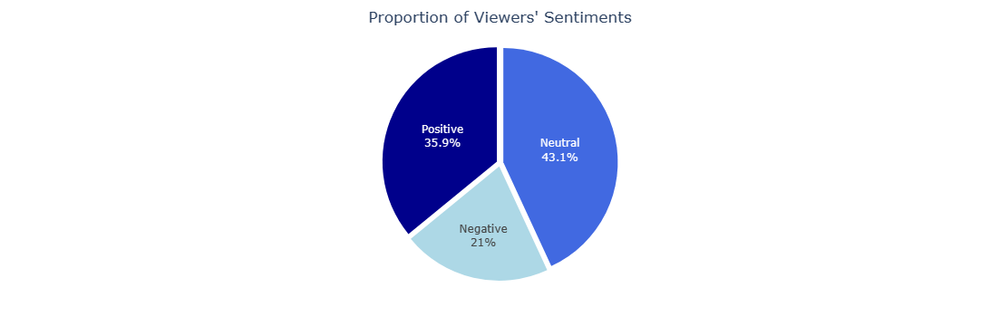

'https://plotly.com/~oge/32/'

In [18]:
#create pie chart showing proportion of viewers' sentiments
fig = px.pie(sentiment_df, values='Count', names='Sentiment', color='Sentiment', color_discrete_map={'Negative':'lightblue',
                                                                                                      'Neutral':'royalblue',
                                                                                                      'Positive':'darkblue'})
fig.update_traces(textinfo='percent+label', pull=[0.03, 0.03, 0.03])
fig.update_layout(title_text=" Proportion of Viewers' Sentiments", width=1100, height=300, title_x=0.5, showlegend=False, margin=dict(r=0, t=50, l=0, b=50))
fig.show()

#export plot to chart studio which I will later embed in my blog post
py.plot(fig, filename="Proportion of Viewers' Sentiments", auto_open = True)

### 5. Tweets Processing <a id='tweets-processing'></a> 

In this section, I used **re** and **NLTK** to process the tweets. I created functions to extract character names and hashtags, perform tokenization, lemmatization, remove stopwords, common words, punctuations, alphabets, emojis, @mentions, hashtags(#...), links(https or http or www) and digits from the tweets.  

##### Extracting names of cast members

In [19]:
#full list of cast members and their misspelt names
cast_members = ['laura', 'lara', 'lora', 'mariam', 'marriam', 'miriam', 'mirian', 'maryam', 'maryan', 'toyin', 'tiannah', 
                'tianna', 'tianah', 'tiana', 'chioma', 'choma', 'iyabo', 'iyaba', 'faith', 'faiht', 'tania', 'tana', 'tannia', 'tanya']

#function to extract names of cast members
def get_cast_members(tweet):
    tweet = tweet.lower() #return tweet in lower case
    tokens = word_tokenize(tweet) #split the tweet into tokens
    cast_names = [name for name in tokens if name in cast_members] #return names of cast members in tweet
    return " ".join(cast_names)

In [20]:
#testing the get_cast_members function on a randomly selected tweet
text = "Anyways let me take this serious like Tianna because baby Marriam is not making sense, your friend doesn't remember the fight. #RHOLagos"
get_cast_members(text)

'tianna marriam'

In [21]:
#applying the get_cast_members function to each entry in 'Text' column and storing the result in a new column 'Cast'
df1['Cast'] = df1['Text'].apply(get_cast_members)
df1.head()

,Tweet_ID,Time_Created,Text,Likes,Retweets,Location,Sentiment,Cast
0,1707549683692765442,2023-09-29 00:15:43,It’s here.💃🏾💃🏾\n\n#RHOLagos Season 2💕 https://...,3,0,---,Neutral,
1,1707553243100819753,2023-09-29 00:29:52,RHOL S2🎉🎉,0,0,Port Harcourt,Neutral,
2,1707554556542918936,2023-09-29 00:35:05,Watching RHOL before y’all wake up and spoil i...,0,0,Where I'm meant to be,Neutral,
3,1707555697502654959,2023-09-29 00:39:37,@stephenkobams Abeg as you dey watch RHOL...pu...,0,0,"Lagos, Nigeria",Neutral,
4,1707558110154342402,2023-09-29 00:49:13,"@ifaycoree RHOLAGOS don come out dear, we stil...",0,0,"Lagos, Nigeria",Neutral,


The head of the dataset does not contain the name of any cast member. Let's view the tail.

In [22]:
df1.tail()

,Tweet_ID,Time_Created,Text,Likes,Retweets,Location,Sentiment,Cast
52225,1736892017324552572,2023-12-18 23:31:41,Your friend pulls you to the ground and you ar...,5,1,"Succes, Strategy, Prayer 🔁 🖤",Negative,
52226,1736897371915669935,2023-12-18 23:52:58,Lying Liar Dr. Rommel! Geez! \n\nYou are a pat...,3,2,"Succes, Strategy, Prayer 🔁 🖤",Negative,
52227,1736898304292557271,2023-12-18 23:56:40,"TBH, Mariam &amp; Toyin were my faves this sea...",0,0,"Lagos, Nigeria",Positive,mariam toyin mariam iyabo laura faith
52228,1736898802131325138,2023-12-18 23:58:39,“Wearing high heel this morning” but then gass...,5,0,world of my own,Positive,
52229,1736898925208977566,2023-12-18 23:59:08,Well Chioma etiquette is you’re not supposed t...,1,0,"Minnesota, USA",Neutral,chioma


In [23]:
#function to correct misspelt cast member names
def get_correct_names(text):
    
    cast = [('lara', 'laura'), ('lora', 'laura'), ('marriam', 'mariam'), ('mirian', 'mariam'), ('maryam', 'mariam'), ('miriam', 'mariam'), 
            ('maryan', 'mariam'), ('tianah', 'toyin'), ('tiana', 'toyin'), ('tiannah', 'toyin'), ('tianna', 'toyin'), ('choma', 'chioma'), 
            ('iyaba', 'iyabo'), ('faiht', 'faith'), ('tana', 'tania'), ('tannia', 'tania'), ('tanya', 'tania')] 

    for name, repl in cast:
        text = re.sub(name, repl, text) #replace the incorrectly spelt name with the correct spelling 
    return text

In [24]:
#testing the get_correct_names function
text = "tianna marriam"
get_correct_names(text)

'toyin mariam'

In [25]:
#applying the get_correct_names function to each entry in 'Cast' column
df1['Cast'] = df1['Cast'].apply(get_correct_names)
df1.tail()

,Tweet_ID,Time_Created,Text,Likes,Retweets,Location,Sentiment,Cast
52225,1736892017324552572,2023-12-18 23:31:41,Your friend pulls you to the ground and you ar...,5,1,"Succes, Strategy, Prayer 🔁 🖤",Negative,
52226,1736897371915669935,2023-12-18 23:52:58,Lying Liar Dr. Rommel! Geez! \n\nYou are a pat...,3,2,"Succes, Strategy, Prayer 🔁 🖤",Negative,
52227,1736898304292557271,2023-12-18 23:56:40,"TBH, Mariam &amp; Toyin were my faves this sea...",0,0,"Lagos, Nigeria",Positive,mariam toyin mariam iyabo laura faith
52228,1736898802131325138,2023-12-18 23:58:39,“Wearing high heel this morning” but then gass...,5,0,world of my own,Positive,
52229,1736898925208977566,2023-12-18 23:59:08,Well Chioma etiquette is you’re not supposed t...,1,0,"Minnesota, USA",Neutral,chioma


In [26]:
#counting the number of cast member mentions
cast_members = df1['Cast'].tolist()
names = []
for x in cast_members:
    x = x.split()
    for i in x:
        names.append(i)
        
print("The total number of cast member mentions is {}.".format(len(names)))
print("The total number of cast members is {}.".format(len(set(names))))

The total number of cast member mentions is 50268.
The total number of cast members is 7.


In [27]:
cast_counter = Counter(names) #count the number of mentions of each cast member in 'names'
b = cast_counter.most_common() #return list of all cast members and their frequency in descending order

b = [(k.title(),v) for (k,v) in b] #to capitalize each cast member's name

cast_df = pd.DataFrame(b, columns=['Cast_member', 'No. of mentions']) #convert frequency list of cast members to a dataframe 
cast_df

,Cast_member,No. of mentions
0,Faith,12198
1,Iyabo,10514
2,Chioma,7819
3,Mariam,6748
4,Laura,4803
5,Toyin,4710
6,Tania,3476


In [28]:
#add percentage of mentions of each cast member to cast_df
cast_df['Percentage (%)'] = 100*(cast_df['No. of mentions'] / cast_df['No. of mentions'].sum())
cast_df

,Cast_member,No. of mentions,Percentage (%)
0,Faith,12198,24.265935
1,Iyabo,10514,20.915891
2,Chioma,7819,15.554627
3,Mariam,6748,13.424047
4,Laura,4803,9.554786
5,Toyin,4710,9.369778
6,Tania,3476,6.914936


##### Extracting hashtags from tweet

In [29]:
#function to extract hastags used in tweet
def get_hashtags(tweet):
    tweet = tweet.lower() #return tweet in lower case
    tweet = tweet.split() #to get a list of words to be able to iterate through
    hashtag = [word for word in tweet if re.search('^#\w+', word)] #create a list of hashtags in tweet
    return " ".join(hashtag)

In [30]:
#testing the get_hashtags function
get_hashtags("Faith na correct babe. #RHOLagos")

'#rholagos'

In [31]:
#applying the get_hashtags function to each entry in 'Text' column and storing the result in a new column 'Hashtags'
df1['Hashtags'] = df1['Text'].apply(get_hashtags)
df1.head()

,Tweet_ID,Time_Created,Text,Likes,Retweets,Location,Sentiment,Cast,Hashtags
0,1707549683692765442,2023-09-29 00:15:43,It’s here.💃🏾💃🏾\n\n#RHOLagos Season 2💕 https://...,3,0,---,Neutral,,#rholagos
1,1707553243100819753,2023-09-29 00:29:52,RHOL S2🎉🎉,0,0,Port Harcourt,Neutral,,
2,1707554556542918936,2023-09-29 00:35:05,Watching RHOL before y’all wake up and spoil i...,0,0,Where I'm meant to be,Neutral,,
3,1707555697502654959,2023-09-29 00:39:37,@stephenkobams Abeg as you dey watch RHOL...pu...,0,0,"Lagos, Nigeria",Neutral,,
4,1707558110154342402,2023-09-29 00:49:13,"@ifaycoree RHOLAGOS don come out dear, we stil...",0,0,"Lagos, Nigeria",Neutral,,


In [32]:
#counting the number of hashtags
hashtags = df1['Hashtags'].tolist()
tags = []
for x in hashtags:
    x = x.split()
    for i in x:
        tags.append(i)
        
print("Hashtags were used a total of {} times.".format(len(tags)))
print("The total number of unique hashtags is {}.".format(len(set(tags))))

Hashtags were used a total of 77376 times.
The total number of unique hashtags is 4907.


In [33]:
hashtag_counter = Counter(tags) #count the number of each hashtag in 'tags'
y = hashtag_counter.most_common() #return list of all hashtags and their frequency in descending order

hashtag_df = pd.DataFrame(y, columns=['Hashtag', 'Count']) #convert frequency list of hashtags to a dataframe 
hashtag_df.head(10)

,Hashtag,Count
0,#rholagos,42190
1,#rhol,4953
2,#drrommel,3317
3,#bishopofbotox,1968
4,#shemustbeobeyed,1578
5,#bbnaijaallstars,1364
6,#totliv,1286
7,#realhousewivesoflagos,579
8,#chioma,411
9,#thabangmazibuko,245


In [34]:
#add percentage of hashtag count to hashtag_df
hashtag_df['Percentage %'] = 100*(hashtag_df['Count'] / hashtag_df['Count'].sum()) #get the percentage count of each hashtag
hashtag_df.head(10)

,Hashtag,Count,Percentage %
0,#rholagos,42190,54.525951
1,#rhol,4953,6.401210
2,#drrommel,3317,4.286859
3,#bishopofbotox,1968,2.543424
4,#shemustbeobeyed,1578,2.039392
5,#bbnaijaallstars,1364,1.762821
6,#totliv,1286,1.662014
7,#realhousewivesoflagos,579,0.748294
8,#chioma,411,0.531172
9,#thabangmazibuko,245,0.316636


##### Removing unwanted words from tweet

In [35]:
#CREATING LIST OF STOPWORDS, ALPHABETS, PUNCTUATIONS, COMMON WORDS WHICH WILL BE TAKEN OUT FROM THE TWEETS 
nltk_stopwords = list(stopwords.words('english')) #list of all nltk stopwords 
alphabets = list(string.ascii_lowercase) #list of all english alphabets

#    I initially used list(string.punctuation) to define punctuations but later realized that it did not include all possible 
#    punctuations eg.left double quotation mark, right double quotation mark, en dash, em dash, ellipsis and more. So, I decided 
#    to use a list of unicode characters instead, which worked well.
codepoints = range(sys.maxunicode + 1) #create a sequence of integers from 0 to the maximum unicode code point
punctuations = [c for i in codepoints if category(c := chr(i)).startswith("P")] #list of all Unicode characters that belong to the “Punctuation” category

#here I defined some common words associated with the series that would not be useful in my analysis.
common_words = ['housewives', 'show', 'lagos', 'showmax', 'reality', 'tv', 'season', 'episode','one', 'two', 'faith', 'faiht', 'morey', 'iyabo', 'iyaba', 'chioma', 'choma', 'tania', 'tanya', 
                'tana', 'laura', 'lora', 'lara', 'toyin', 'tiannah', 'tianna', 'tianah', 'tiana', 'mariam', 'marriam', 'maryan', 'maryam', 'miriam',
                'mirian', 'rommel', 'dr', 'drs', 'drrommel', 'rholagos', 'rhol', "n't", "'s", "'re", "'ve", "'d", 'm', 'm ', 'rholshowmax', 'ilebaye', 'cynthia', 'deloitte', 'mercy', 'congratulations', 'voting', 'vote', 
                'bbnaijaallstars', 'bbnaija', 'phyna', '``', '|', 'ceec', 'rashford', '..', '...', '....', 'webbten', 'howard', 'saka', 'tems', 'king', 'erica','mason','bellingham', 'ojo', 'larry', 'sam',
                'howard','liverpool', 'robbed webb klopp','robbed', 'webb','klopp', 'jurgen klopp','jurgen','klopp', 'doku', 'mount', 'gt', 'amp','alway', 'm', 'ten', 'even', 'thabang']

stopwords = nltk_stopwords + common_words #define list of stopwords

In [36]:
#function to remove links, @mentions, hashtags, digits, emojis from tweets, and also tokenize and lemmatize tweets

def get_valid_words(tweet):
    tweet = tweet.lower()  #set all words to lowercase   
    words = tweet.split() #return a list of words to be able to iterate through and exclude some unwanted words
    
    invalid_words = [word for word in words if re.search('@\S+|#\S+|http\S+|www\S+', word)] #create a list of all links, @mentions, hashtags(#) in tweet
    
    numbers = [word for word in words if re.search('\d+', word)] #create a list of all digits in tweet
    
    valid_words = [word for word in words if word not in invalid_words and word not in numbers] #remove invalid words and numbers
    
    valid_words = " ".join(valid_words) #join words in list to form text to be passed to the tokenizer
    
    #     I used the demoji Python package below to remove any emojis in the tweets. Initially, I tried creating
    #     a list of emojis using UNICODE_EMOJI.keys() and excluding them from the tweets, but I realized that this did not 
    #     take out all the emojis. Some emojis were attached to words without spaces between them and some came attached 
    #     together in multiples. These were not taken care of by the initial list of emojis, hence I decided to use 
    #     demoji and it worked perfectly.
    
    valid_words = demoji.replace(valid_words, "") #return the valid words with all emojis taken out
    
    tokens = word_tokenize(valid_words) #tokenize the tweet    
    new_words = [word for word in tokens if word not in stopwords and word not in punctuations and word not in alphabets] #remove stopwords, punctuations and alphabets
    
    WNlemma = WordNetLemmatizer() #create an instance of a WordNet lemmatizer
    lemmatized_words = [WNlemma.lemmatize(word) for word in new_words] #lemmatize resulting words in tweet

    
    lemmatized_words = [word for word in lemmatized_words if word not in alphabets]
    return " ".join(lemmatized_words) 

In [37]:
#testing the get_valid_words function on a random tweet
tweet = "Chioma is very lovable on her own, but ever since she became besties with Iyabo I can’t stand the sight of her.😂💔#RHOLagos #RHOL"
get_valid_words(tweet)

'lovable ever since became besties stand sight'

In [38]:
#applying the get_valid_words function to each entry in 'Text' column and storing the result in a new column 'Words'
df1['Words'] = df1['Text'].apply(get_valid_words)
df1.head()

,Tweet_ID,Time_Created,Text,Likes,Retweets,Location,Sentiment,Cast,Hashtags,Words
0,1707549683692765442,2023-09-29 00:15:43,It’s here.💃🏾💃🏾\n\n#RHOLagos Season 2💕 https://...,3,0,---,Neutral,,#rholagos,
1,1707553243100819753,2023-09-29 00:29:52,RHOL S2🎉🎉,0,0,Port Harcourt,Neutral,,,
2,1707554556542918936,2023-09-29 00:35:05,Watching RHOL before y’all wake up and spoil i...,0,0,Where I'm meant to be,Neutral,,,watching wake spoil
3,1707555697502654959,2023-09-29 00:39:37,@stephenkobams Abeg as you dey watch RHOL...pu...,0,0,"Lagos, Nigeria",Neutral,,,abeg dey watch push vote end today please
4,1707558110154342402,2023-09-29 00:49:13,"@ifaycoree RHOLAGOS don come out dear, we stil...",0,0,"Lagos, Nigeria",Neutral,,,come dear still dey find


### 6. Word Cloud <a id='word-cloud'></a> 

The aim for the word cloud was to show the most common words used to talk about the show. Since I had already extracted the words from each tweet in the Tweets Processing step above, all I had to do was group the words together and use this group of words to create a word cloud.

Since this analysis was about a reality tv series shot in Lagos, Nigeria, I wanted to create the word cloud to have a Lagos state map outline. I acheived this by superimposing the word cloud unto a mask of Lagos map outline. I imported the mask (as an image), converted it into a numpy array, and then using the WordCloud package, superimposed the words unto the mask.

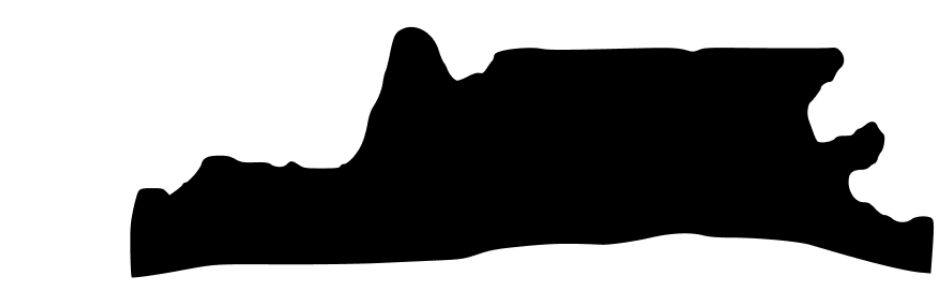

In [39]:
image = np.array(Image.open(r"C:\Users\ogech\Documents\map_of_lagos.png"))  #import the image mask 
fig = plt.figure(figsize=(12, 16))  #specify the figure size

# show the image
plt.imshow(image, cmap=plt.cm.gray, interpolation='bilinear')
plt.axis('off')
plt.show()

In [40]:
#function to return different shades of blue 
def blue_color_func(word, font_size, position, orientation, random_state=None, **kwargs):
    return("hsl(240, 100%, {}%)".format(random.randint(30, 60))) # return different shades of blue colour

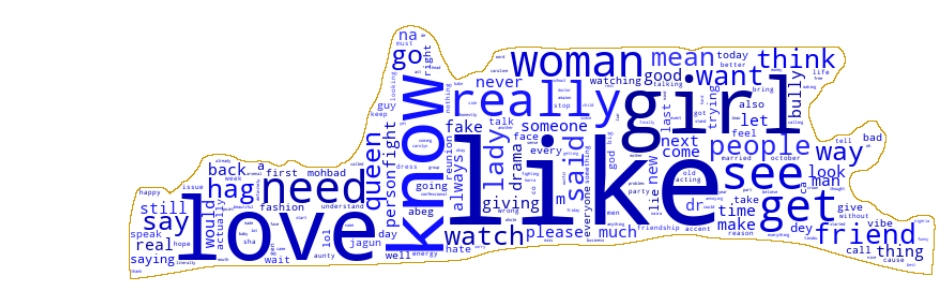

<Figure size 640x480 with 0 Axes>

In [41]:
#PLOTTING THE WORD CLOUD
all_words = " ".join(df1.Words.to_list()) #returns text containing each entry in 'Words' column
text = all_words.split() #split each entry in 'Words' columns. Takes care of the cases where there were more than one word for a tweet

data = " ".join(text)
    
x = WordCloud(background_color = "white", mask=image, contour_width=1, contour_color="#CC9900", collocations=False, stopwords=set())  #instantiate a word cloud object
x = x.generate(data)  #generate the word cloud
x.recolor(color_func = blue_color_func)  #specify the colour(s)

fig = plt.figure(figsize=(12, 16))  #set up the word cloud figure

#display the word cloud
plt.imshow(x, interpolation='bilinear')
plt.axis('off')
plt.show() 

plt.savefig('rhol_wordcloud.png') #save as png file to include in my blog post

##### Most common words

The word cloud shows that some of the most common words used in tweets about the show are: like, love, girl, know, woman, really, etc. To validate this, I used the block of code below to return (in descending order) the top 10 words present in the tweets gathered.

In [42]:
dist = FreqDist(word_tokenize(data)) #  returns a dictionary containing all the words in 'data' and their frequency 
                                     #  distribution. Note that starting from NLTK version 3.0.0, FreqDist now returns the 
                                     #  words in descending order of frequency.

top_10_words = list(dist)[:10]    #returns the 10 most common words
top_words = (', '.join(top_10_words)) #returns each item in the top_10_words list separated by a comma and then a space

print("The top 10 words present in tweets about the show are: {}.".format(top_words))

The top 10 words present in tweets about the show are: like, love, girl, know, really, see, need, get, woman, people.


### 7. Location Geocoding and Map Visualization <a id='location-geocoding'></a> 

As a final step in this project, I wanted to create a map showing the locations where the tweets were coming from. Note that the location information on some tweeters' profiles was vague (eg. somewhere in Port Harcourt City), so  I needed a platform that would take in free-form text, and then extract and return the country name, latitude and longitude of any location available in the text. I considered using Google Geocoding API or Here Geocoder API, but decided to stick with one of python's geocoding libraries (geopy), in order to avoid charges that could be incurred by using the former. I created a function that used geopy's Nominatim geocoder to extract the latitude, longitude and country name from free-form text.

##### Location Geocoding

In [43]:
#function to return latitude, longitude and country name for tweet location 
def get_location_info(location_str):
    geolocator = Nominatim(user_agent="XXXXXX") #specifying my user agent
    geocode = RateLimiter(geolocator.geocode, min_delay_seconds=1) # specifying to ensure 1 request per second as per Nominatim's rate limit.
                                                                   # Without this, I could encounter a 403 error due to so many requests 
    location = geocode(location_str, language = 'en')
    if location:
        try:
            latitude = location.latitude  #return latitude
            longitude = location.longitude  #return longitude 
            country = location.address.split(",")[-1].strip()  #return the country name
        #if there is an error return NaN
        except (ResponseError, AttributeError):
            latitude = float('NaN')
            longitude = float('NaN')
            country = float('NaN')
    else:
        latitude = float('NaN')
        longitude = float('NaN')
        country = float('NaN')
        
    return (latitude, longitude, country)


In [44]:
#trying out the get_location_info function
# text = 'Somewhere in Port Harcourt City'
# get_location_info(text)

p= (4.7676576, 7.0188527, 'Nigeria')
p

(4.7676576, 7.0188527, 'Nigeria')

In [45]:
#applying the get_location_info function to each entry in the 'Tweet_Location' column and storing the result in a new column 'Location'
# df1['Location_Details'] = df1['Location'].apply(get_location_info)
# df1.head()


df4 = pd.read_csv(r'C:\Users\ogech\Documents\Datasets\RHOL_Location.csv')
df4['Cast'] = df4['Cast'].fillna(' ')
df4['Hashtags'] = df4['Hashtags'].fillna(' ')
df4['Words'] = df4['Words'].fillna(' ')
df4.head()

,Tweet_ID,Time_Created,Text,Likes,Retweets,Location,Sentiment,Cast,Hashtags,Words,Location_Details
0,1707549683692765442,2023-09-29 00:15:43,It’s here.💃🏾💃🏾\n\n#RHOLagos Season 2💕 https://...,3,0,---,Neutral,,#rholagos,,"(nan, nan, nan)"
1,1707553243100819753,2023-09-29 00:29:52,RHOL S2🎉🎉,0,0,Port Harcourt,Neutral,,,,"(4.7676576, 7.0188527, 'Nigeria')"
2,1707554556542918936,2023-09-29 00:35:05,Watching RHOL before y’all wake up and spoil i...,0,0,Where I'm meant to be,Neutral,,,watching wake spoil,"(nan, nan, nan)"
3,1707555697502654959,2023-09-29 00:39:37,@stephenkobams Abeg as you dey watch RHOL...pu...,0,0,"Lagos, Nigeria",Neutral,,,abeg dey watch push vote end today please,"(6.4550575, 3.3941795, 'Nigeria')"
4,1707558110154342402,2023-09-29 00:49:13,"@ifaycoree RHOLAGOS don come out dear, we stil...",0,0,"Lagos, Nigeria",Neutral,,,come dear still dey find,"(6.4550575, 3.3941795, 'Nigeria')"


In [46]:
#storing latitude, longitude and country in different columns
# df1[['Latitude', 'Longitude', 'Country']] = pd.DataFrame(df1['Location_Details'].tolist(), index=df1.index)
# df1.head()


df3 = pd.read_csv(r'C:\Users\ogech\Documents\Datasets\RHOL_Location2.csv')
df3['Cast'] = df4['Cast'].fillna(' ')
df3['Hashtags'] = df4['Hashtags'].fillna(' ')
df3['Words'] = df4['Words'].fillna(' ')
df3.head()

,Tweet_ID,Time_Created,Text,Likes,Retweets,Location,Sentiment,Cast,Hashtags,Words,Location_Details,Latitude,Longitude,Country
0,1707549683692765442,2023-09-29 00:15:43,It’s here.💃🏾💃🏾\n\n#RHOLagos Season 2💕 https://...,3,0,---,Neutral,,#rholagos,,"(nan, nan, nan)",NaN,NaN,NaN
1,1707553243100819753,2023-09-29 00:29:52,RHOL S2🎉🎉,0,0,Port Harcourt,Neutral,,,,"(4.7676576, 7.0188527, 'Nigeria')",4.767658,7.018853,Nigeria
2,1707554556542918936,2023-09-29 00:35:05,Watching RHOL before y’all wake up and spoil i...,0,0,Where I'm meant to be,Neutral,,,watching wake spoil,"(nan, nan, nan)",NaN,NaN,NaN
3,1707555697502654959,2023-09-29 00:39:37,@stephenkobams Abeg as you dey watch RHOL...pu...,0,0,"Lagos, Nigeria",Neutral,,,abeg dey watch push vote end today please,"(6.4550575, 3.3941795, 'Nigeria')",6.455057,3.394179,Nigeria
4,1707558110154342402,2023-09-29 00:49:13,"@ifaycoree RHOLAGOS don come out dear, we stil...",0,0,"Lagos, Nigeria",Neutral,,,come dear still dey find,"(6.4550575, 3.3941795, 'Nigeria')",6.455057,3.394179,Nigeria


##### Map Visualization

After getting the latitudes, longitudes and country names, I proceeded to create a map to visualize the locations where the tweets were coming from. To do this, I created a subset of the dataset with only the entries that had actual location information, and then dispalyed the locations on a world map, using python's Folium library.

In [47]:
#creating a new dataframe with only the entries that have actual location data
# df_locations = df1[df1['Country'].notna()]
# df_locations.head()

df_locations = df3[df3['Country'].notna()]
df_locations.head()

,Tweet_ID,Time_Created,Text,Likes,Retweets,Location,Sentiment,Cast,Hashtags,Words,Location_Details,Latitude,Longitude,Country
1,1707553243100819753,2023-09-29 00:29:52,RHOL S2🎉🎉,0,0,Port Harcourt,Neutral,,,,"(4.7676576, 7.0188527, 'Nigeria')",4.767658,7.018853,Nigeria
3,1707555697502654959,2023-09-29 00:39:37,@stephenkobams Abeg as you dey watch RHOL...pu...,0,0,"Lagos, Nigeria",Neutral,,,abeg dey watch push vote end today please,"(6.4550575, 3.3941795, 'Nigeria')",6.455057,3.394179,Nigeria
4,1707558110154342402,2023-09-29 00:49:13,"@ifaycoree RHOLAGOS don come out dear, we stil...",0,0,"Lagos, Nigeria",Neutral,,,come dear still dey find,"(6.4550575, 3.3941795, 'Nigeria')",6.455057,3.394179,Nigeria
5,1707560231335535000,2023-09-29 00:57:38,Is Toyin the problem this season? Makes sense ...,3,0,"Johannesburg, South Africa",Neutral,toyin,,problem make sense know gaslight,"(-26.205, 28.049722, 'South Africa')",-26.205000,28.049722,South Africa
6,1707561008133275655,2023-09-29 01:00:43,The confessional looks 🔥🔥🔥🔥🔥 I forgot how thes...,2,0,"Johannesburg, South Africa",Neutral,,#rholagos,confessional look forgot lady bring,"(-26.205, 28.049722, 'South Africa')",-26.205000,28.049722,South Africa


In [48]:
#define the world map
world_map = folium.Map()

mentions = folium.map.FeatureGroup()

#loop through all the entries to add each entry's location
for lat, lng, in zip(df_locations.Latitude, df_locations.Longitude):
    mentions.add_child(
        folium.vector_layers.CircleMarker(
            [lat, lng],
            radius=5, 
            color='yellow',
            fill=True,
            fill_color='blue',
            fill_opacity=0.6
        )
    )

#add mentions to the map
world_map.add_child(mentions)

As expected, most of the tweets were from Nigeria as seen on the map. Let's also validate this using the code block below.

In [49]:
#return the top five countries and the number of tweets from them
top_countries = df_locations.Country.value_counts()[:5]
top_countries

Country
Nigeria           11125
South Africa       6180
United States      3247
United Kingdom     1917
Ghana               707
Name: count, dtype: int64

At this point, I was done with my analysis and it was time to store the resulting dataset as csv for use in creating Tableau dashboard. Preview the head of my final dataset before export.

In [50]:
# df1.head()

df5 = pd.read_csv(r'C:\Users\ogech\Documents\Datasets\RHOL_final_dataset.csv')
df5['Cast'] = df5['Cast'].fillna(' ')
df5['Hashtags'] = df5['Hashtags'].fillna(' ')
df5['Words'] = df5['Words'].fillna(' ')
df5.head()

,Tweet_ID,Time_Created,Text,Likes,Retweets,Location,Sentiment,Cast,Hashtags,Words,Location_Details,Latitude,Longitude,Country
0,1707549683692765442,2023-09-29 00:15:43,It’s here.💃🏾💃🏾\n\n#RHOLagos Season 2💕 https://...,3,0,---,Neutral,,#rholagos,,"(nan, nan, nan)",NaN,NaN,NaN
1,1707553243100819753,2023-09-29 00:29:52,RHOL S2🎉🎉,0,0,Port Harcourt,Neutral,,,,"(4.7676576, 7.0188527, 'Nigeria')",4.767658,7.018853,Nigeria
2,1707554556542918936,2023-09-29 00:35:05,Watching RHOL before y’all wake up and spoil i...,0,0,Where I'm meant to be,Neutral,,,watching wake spoil,"(nan, nan, nan)",NaN,NaN,NaN
3,1707555697502654959,2023-09-29 00:39:37,@stephenkobams Abeg as you dey watch RHOL...pu...,0,0,"Lagos, Nigeria",Neutral,,,abeg dey watch push vote end today please,"(6.4550575, 3.3941795, 'Nigeria')",6.455057,3.394179,Nigeria
4,1707558110154342402,2023-09-29 00:49:13,"@ifaycoree RHOLAGOS don come out dear, we stil...",0,0,"Lagos, Nigeria",Neutral,,,come dear still dey find,"(6.4550575, 3.3941795, 'Nigeria')",6.455057,3.394179,Nigeria


In [51]:
#save the cleaned dataset 
# df1.to_csv(r'C:\Users\ogech\Documents\Datasets\RHOL_final_dataset.csv', index = False)
import pandas as pd

### THANK YOU FOR GOING THROUGH MY NOTEBOOK !!